In [ ]:
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import accuracy_score
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report
import h5py
import os
from tensorflow.keras import layers
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, Add, UpSampling2D, Reshape
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow.keras.backend as K

import warnings

# Ignore all warnings
warnings.filterwarnings("ignore")

# Your code here

# Reset the warning filter if needed
warnings.resetwarnings()


In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

/usr/local/lib/python3.10/dist-packages/pexpect/popen_spawn.py:60: DeprecationWarning: setDaemon() is deprecated, set the daemon attribute instead
  self._read_thread.setDaemon(True)


Mounted at /content/drive


In [ ]:
cd /content/drive/MyDrive/anomaly/mvtec_anomaly_detection/

/content/drive/.shortcut-targets-by-id/1W01KwNde9fWkWs9206tNtZsdc3BVs97m/anomaly/mvtec_anomaly_detection


In [ ]:
ls

 Autoencoder.ipynb                      hybrid_model.ipynb
 baseline.ipynb                         medium_article_2_classes.ipynb
 base_model.ipynb                       medium_article_one_class_cnn.ipynb
 cable.ipynb                            midterm.gslides
'Copy of stacked_autoencoder.ipynb'     mvtec_anomaly_detection/
'full_data_Copy of Autoencoder.ipynb'  'one_pic_Copy of Autoencoder.ipynb'
 good/                                  pill.ipynb
 good.zip                               pill_type/
 hazelnut-buraks-model.ipynb            stacked_autoencoder.ipynb
 hazelnut.ipynb                         support_vector_machines.ipynb


In [ ]:
# Define the folder path to tarak
folder_path = '/content/drive/MyDrive/anomaly/mvtec_anomaly_detection/'
# Only Hazelnuts
subfolders = ['carpet']

# Define the list of subfolder names
# subfolders = ['pill', 'zipper', 'tile', 'bottle', 'transistor', 'wood', 'cable', 'capsule', 'carpet', 'grid', 'hazelnut', 'leather', 'metal_nut', 'screw', 'toothbrush']

### Load 180 shape

In [ ]:
# Initialize lists to store images and labels
images = []
labels = []

# Assign '0' as the label for all images
label = 0

# Loop through the subfolders
for subfolder in subfolders:
    subfolder_path = os.path.join(folder_path, subfolder, 'train', 'good')

    # Loop through the .png files in the "good" folder
    for filename in os.listdir(subfolder_path):
        if filename.endswith(".png"):
            image_path = os.path.join(subfolder_path, filename)
            # Load the image using OpenCV
            image = cv2.imread(image_path)
            # Resize the image to (800, 800) if needed
            if image.shape[:2] != (180,180):
                image = cv2.resize(image, (180, 180))
            # Append the image and its label '0' to the lists
            images.append(image)
            labels.append(label)

In [ ]:
# Convert the data to NumPy arrays
train_images = np.array(images)
train_labels = np.array(labels)


train_images = train_images.astype("float32") / 255

In [ ]:
train_images.ndim,train_images.shape,len(train_images), train_images.dtype

(4, (280, 180, 180, 3), 280, dtype('float32'))

# Resnet50 and autoencoder Model

In [ ]:
from tensorflow.keras import backend as K
K.clear_session()

In [ ]:
from tensorflow.keras.optimizers import Adam

# Function to create the ResNet-50 based feature extractor
def create_resnet50_feature_extractor(input_shape=(180, 180, 3)):
    base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
    feature_extractor = Model(inputs=base_model.input, outputs=base_model.get_layer('conv5_block3_out').output)
    return feature_extractor

def residual_block(x, filters, kernel_size=3, strides=1):
    res = Conv2D(filters, kernel_size=kernel_size, strides=strides, padding='same')(x)
    res = BatchNormalization()(res)
    res = Activation('relu')(res)

    res = Conv2D(filters, kernel_size=kernel_size, strides=strides, padding='same')(res)
    res = BatchNormalization()(res)

    return Add()([x, res])

def encoder(inputs):
    x = Conv2D(128, kernel_size=3, activation='relu', padding='same')(inputs)
    x = BatchNormalization()(x)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    latent_representation = x
    return latent_representation

def decoder(latent_representation, original_shape):
    x = Conv2D(128, kernel_size=3, activation='relu', padding='same')(latent_representation)
    x = BatchNormalization()(x)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = residual_block(x, 128)
    x = Conv2D(3, kernel_size=3, activation='sigmoid', padding='same')(x)
    x = Reshape(original_shape)(x)
    return x

# Create the autoencoder
def create_autoencoder(input_shape=(180, 180, 3)):
    inputs = Input(shape=input_shape)
    encoded = encoder(inputs)
    decoded = decoder(encoded, input_shape)
    autoencoder = Model(inputs, decoded)
    autoencoder.compile(optimizer=Adam(learning_rate= 0.0001 ), loss='mse')
    return autoencoder

# Define data augmentation settings
datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Create a custom data augmentation generator for single-channel images
# Assuming you have train_images and train_images as your training data
augmented_images = []
for image in train_images:
    augmented_image = datagen.random_transform(image)
    augmented_images.append(augmented_image)

augmented_images = np.array(augmented_images)

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_loss', save_best_only=True)

# Your existing code for creating the ResNet-50 based feature extractor
feature_extractor = create_resnet50_feature_extractor()

# Use the feature extractor to obtain features from the augmented training data
features = feature_extractor.predict(augmented_images)

# Your existing code for anomaly detection using the autoencoder
autoencoder = create_autoencoder()
autoencoder.fit(
    augmented_images,
    augmented_images,
    epochs=10,
    batch_size=8,
    # validation_split=0.2,  # You should adjust this based on your preference
    callbacks=[early_stopping, model_checkpoint]
)


9/9 [==============================] - 2s 169ms/step
Epoch 1/10
35/35 [==============================] - ETA: 0s - loss: 0.0640

35/35 [==============================] - 73s 2s/step - loss: 0.0640
Epoch 2/10
35/35 [==============================] - ETA: 0s - loss: 0.0097

35/35 [==============================] - 57s 2s/step - loss: 0.0097
Epoch 3/10
35/35 [==============================] - ETA: 0s - loss: 0.0053

35/35 [==============================] - 58s 2s/step - loss: 0.0053
Epoch 4/10
35/35 [==============================] - ETA: 0s - loss: 0.0045

35/35 [==============================] - 58s 2s/step - loss: 0.0045
Epoch 5/10
35/35 [==============================] - ETA: 0s - loss: 0.0032

35/35 [==============================] - 58s 2s/step - loss: 0.0032
Epoch 6/10
35/35 [==============================] - ETA: 0s - loss: 0.0027

35/35 [==============================] - 58s 2s/step - loss: 0.0027
Epoch 7/10
35/35 [==============================] - ETA: 0s - loss: 0.0021

35/35 [==============================] - 58s 2s/step - loss: 0.0021
Epoch 8/10
35/35 [==============================] - ETA: 0s - loss: 0.0019

35/35 [==============================] - 58s 2s/step - loss: 0.0019
Epoch 9/10
35/35 [==============================] - ETA: 0s - loss: 0.0016

35/35 [==============================] - 58s 2s/step - loss: 0.0016
Epoch 10/10
35/35 [==============================] - ETA: 0s - loss: 0.0020

35/35 [==============================] - 58s 2s/step - loss: 0.0020


In [ ]:
# autoencoder.summary()

# Load the test data

In [ ]:


# Define the path to the test dataset
test_folder_path = '/content/drive/MyDrive/anomaly/mvtec_anomaly_detection/'
subfolders = ['carpet']

# Initialize lists to store test images and labels
test_images = []
test_labels = []

# Assign '1' as the label for all images
t_label = 1

# Loop through the subfolders
for subfolder in subfolders:
    subfolder_path = os.path.join(test_folder_path, subfolder, 'test', 'cut')

    # Loop through the .png files in the "crack" folder
    for filename in os.listdir(subfolder_path):
        if filename.endswith(".png"):
            image_path = os.path.join(subfolder_path, filename)

            # Load the image using OpenCV
            t_image = cv2.imread(image_path)

            # Resize the image to (180, 180) if needed
            if t_image.shape[:2] != (180, 180):
                t_image = cv2.resize(t_image, (180, 180))

            # Append the image and its label '1' to the lists
            test_images.append(t_image)
            test_labels.append(t_label)

# Convert the lists to numpy arrays
test_images = np.array(test_images)
test_labels = np.array(test_labels)

# Normalize the test images to the range [0, 1]
norm_anomaly = test_images / 255.0


In [ ]:
norm_anomaly.shape, test_images[0].shape

((17, 180, 180, 3), (180, 180, 3))

In [ ]:
# Encode the test image
latent_representation = encoder(norm_anomaly)

# Reconstruct the test image
reconstructed_image = decoder(latent_representation, (180,180,3) )

# Calculate the reconstruction error
reconstruction_error = tf.keras.losses.mean_squared_error(norm_anomaly, reconstructed_image)
error_image = tf.abs(norm_anomaly - reconstructed_image)

In [ ]:
print('reconstruction error', np.max(reconstruction_error))
print('error_image', np.max(error_image))

reconstruction error 0.5916682
error_image 0.915256


# Set Threshold

In [ ]:

# Assuming `train_images` is your training dataset
train_reconstructions = autoencoder.predict(train_images)

# Calculate the reconstruction errors on the training set
train_errors = np.mean(np.square(train_images - train_reconstructions), axis=(1, 2, 3))
train_reconstruction_error = tf.keras.losses.mean_squared_error(train_images, train_reconstructions)

# Set the threshold based on mean and standard deviation
threshold = np.mean(train_errors ) + 2 * np.std(train_errors )
print (np.mean(train_reconstruction_error ) + 2 * np.std(train_reconstruction_error))

# Print or visualize the threshold
print("Train_Threshold:", threshold)

9/9 [==============================] - 16s 2s/step
0.050713359378278255
Train_Threshold: 0.016409387812018394


# Anomaly detection

In [ ]:


# Display the original image and reconstruction
original_image = norm_anomaly  # Convert to NumPy array
reconstruction = reconstruction_error[0].numpy()  # Convert to NumPy array

# Convert reconstructed_image to a NumPy array
reconstructed_image_numpy = reconstructed_image[0].numpy()


# Convert the reconstruction error tensor to a numpy array
reconstruction_error_numpy = reconstruction_error.numpy()

# Check if the reconstruction error is greater than the threshold for all elements in the array
if np.any(reconstruction_error_numpy > threshold):
    print("Anomaly_er",np.max(error_image))
    print("Anomaly_re",np.max(reconstruction_error.numpy()))
    print("Threshold", threshold)

else:
   print("No Anomaly", np.max(reconstruction_error_numpy))


Anomaly_er 0.7329634
Anomaly_re 0.30406368
Threshold 0.016409387812018394


In [ ]:


# Assuming `autoencoder` is already trained and `norm_anomaly` is a normalized anomaly image
re_auto = autoencoder.predict(norm_anomaly)

# Calculate the reconstruction error as the mean squared error
reconstruction_er = np.mean(np.square(norm_anomaly - re_auto))

# # Define a threshold value based on your specific use case
# threshold = 0.1  # You should adjust this threshold based on your data and requirements

# Check if the maximum reconstruction error exceeds the threshold to determine if it's an anomaly
if np.any(reconstruction_er > threshold):
  print('Anomaly detected')
  print('Max Reconstruction Error:', np.max(reconstruction_er))
  print('Threshold:', threshold)
else:
  print('No anomaly')
  print('Max Reconstruction Error:', np.max(reconstruction_er))
  print('Threshold:', threshold)



1/1 [==============================] - 0s 27ms/step
No anomaly
Max Reconstruction Error: 0.014290894375167135
Threshold: 0.016409387812018394


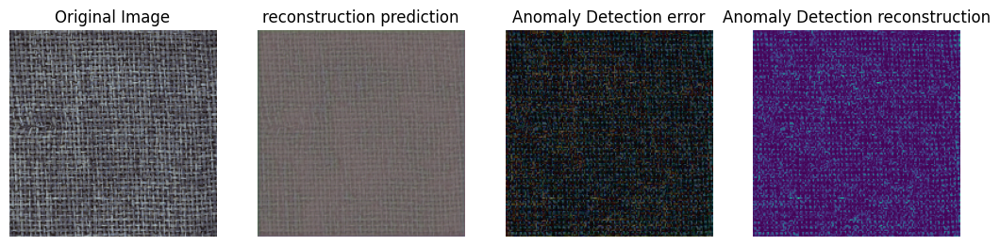

No Anomaly


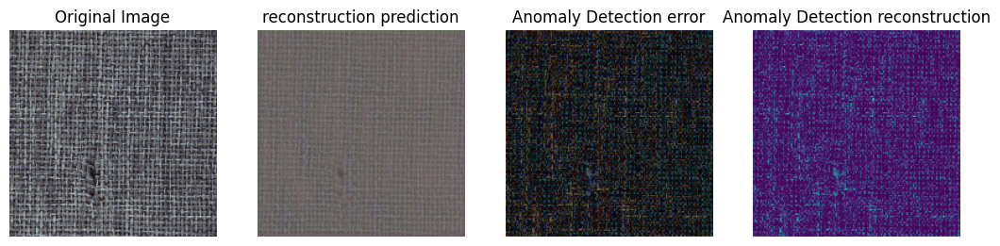

No Anomaly


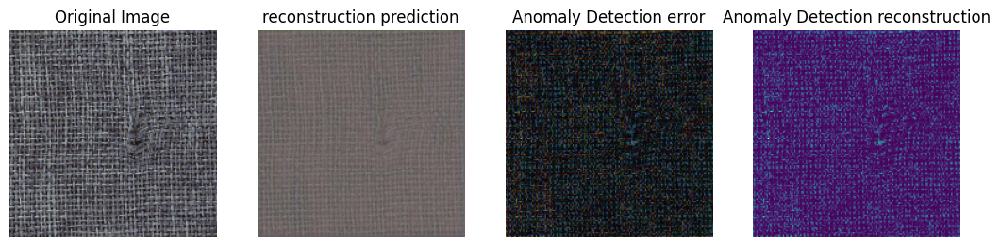

No Anomaly


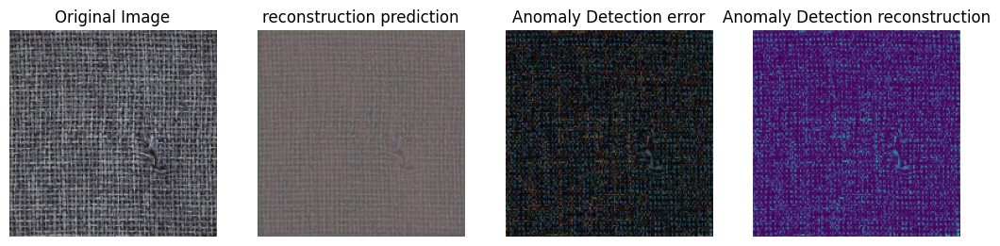

No Anomaly


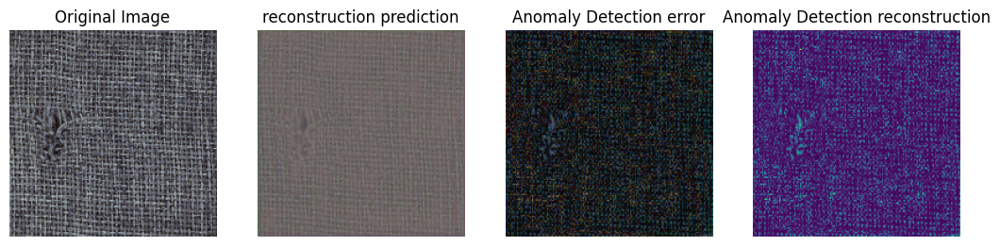

No Anomaly


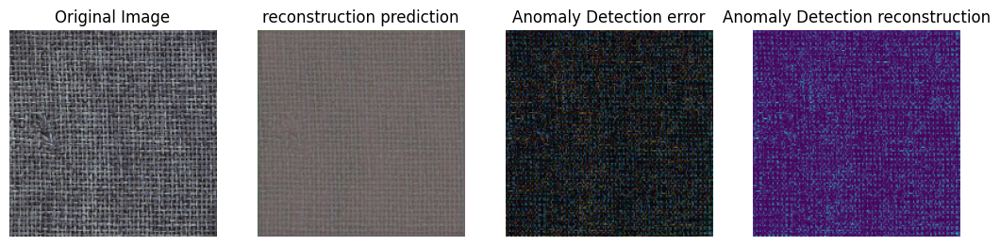

No Anomaly


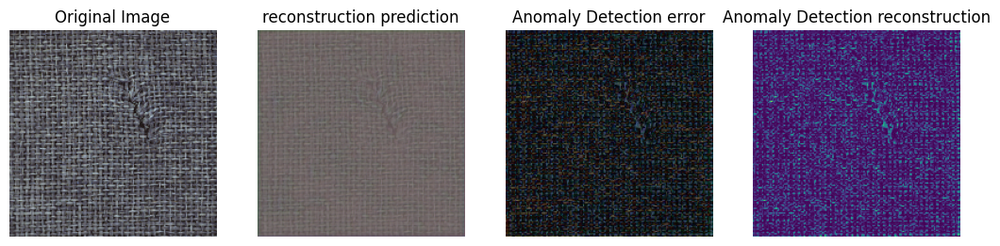

No Anomaly


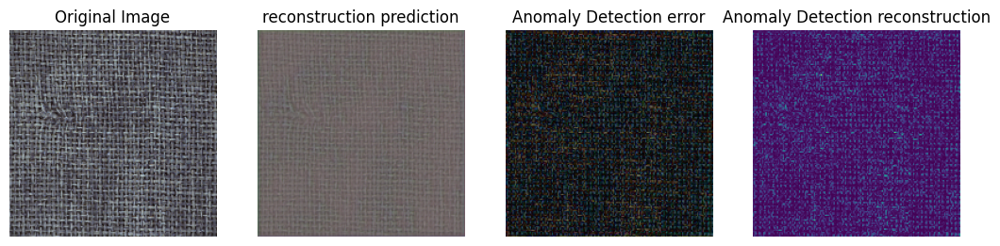

No Anomaly


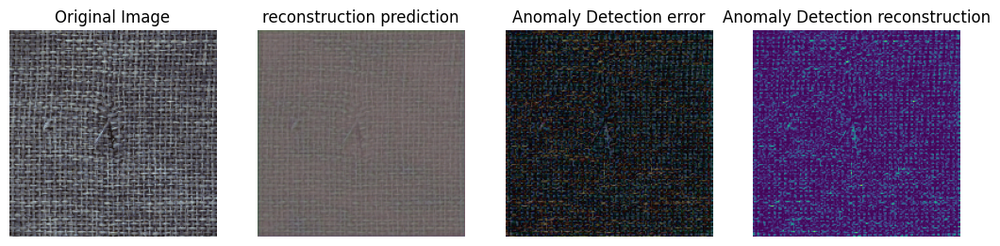

No Anomaly


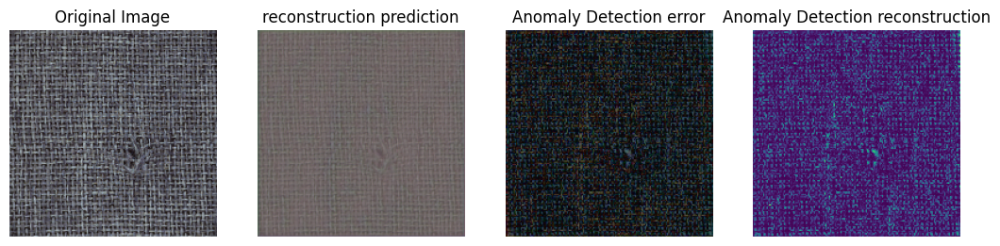

No Anomaly


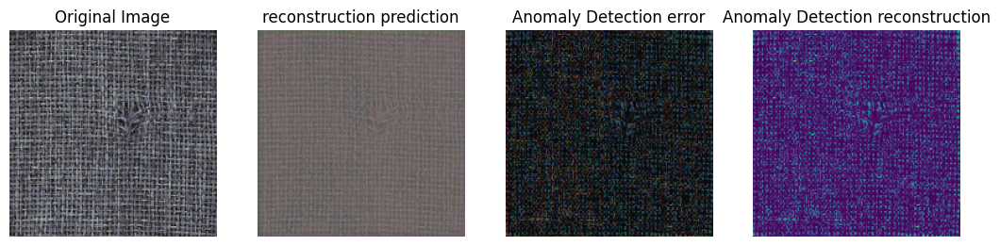

No Anomaly


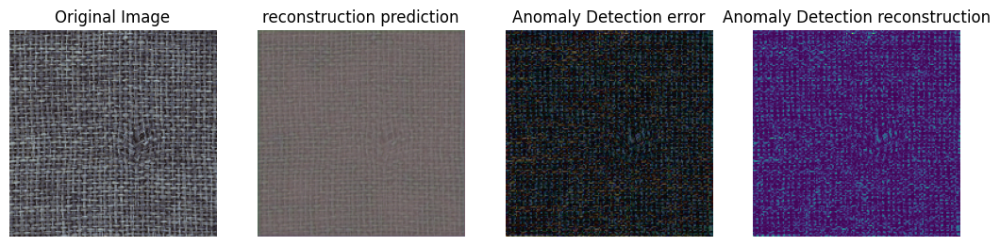

No Anomaly


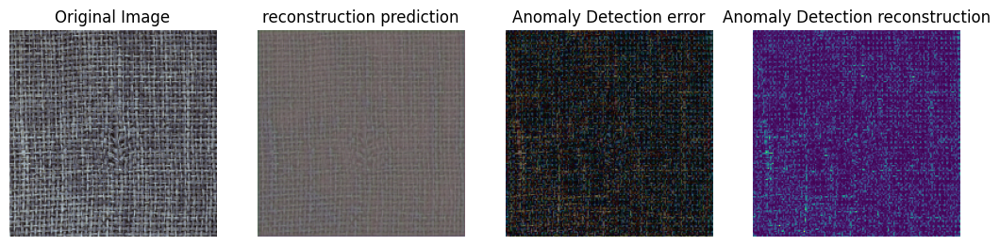

No Anomaly


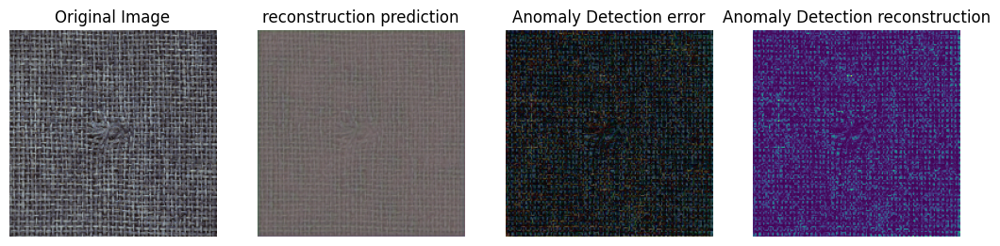

No Anomaly


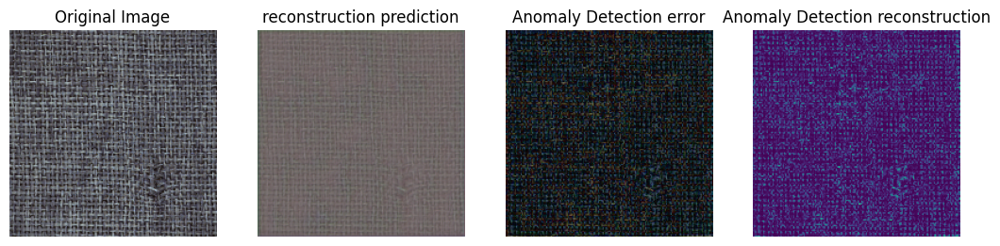

No Anomaly


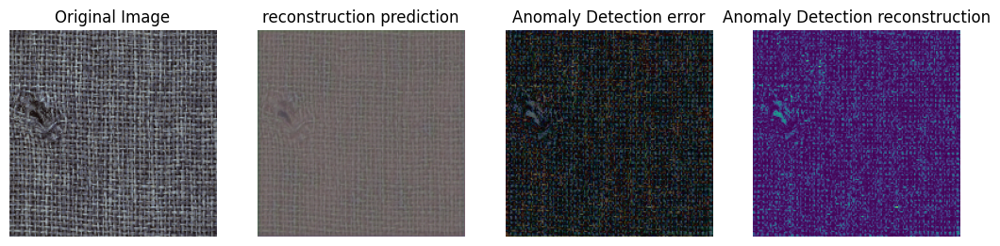

No Anomaly


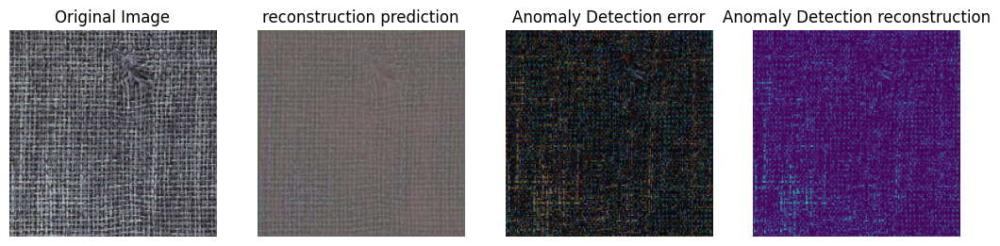

No Anomaly


In [ ]:
# Display the composite image with the heatmap

for idx in range(len(norm_anomaly)):
    plt.figure(figsize=(13, 8))
    plt.subplot(1, 4, 1)
    plt.title("Original Image")
    plt.imshow(original_image[idx])
    plt.axis('off')
    plt.subplot(1, 4, 2)
    plt.title("reconstruction prediction")
    plt.imshow(re_auto[idx])
    plt.axis('off')
    plt.subplot(1, 4, 3)
    plt.title("Anomaly Detection error")
    plt.imshow(error_image[idx])
    plt.axis('off')
    plt.subplot(1, 4, 4)
    plt.title("Anomaly Detection reconstruction")
    plt.imshow(reconstruction_error_numpy[idx])
    plt.axis('off')

    plt.show()

    # Classify images based on the threshold
    if np.any(reconstruction_er > threshold):
      print("Anomaly")
    else:
      print("No Anomaly")

plt.show()

# Rectangle Box and segementation

1/1 [==============================] - 0s 27ms/step


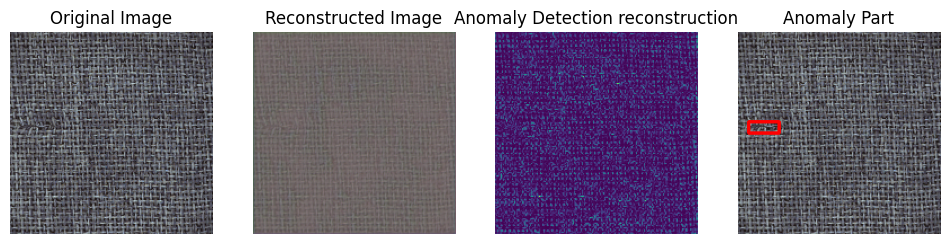

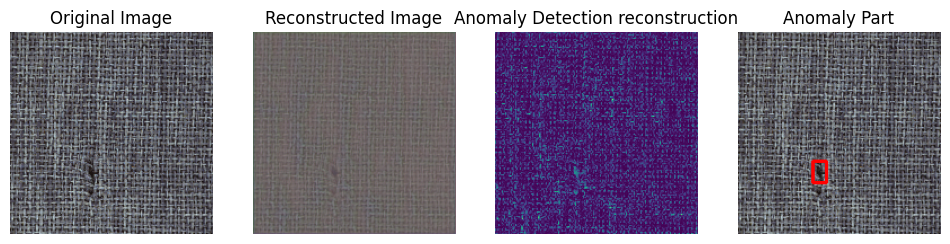

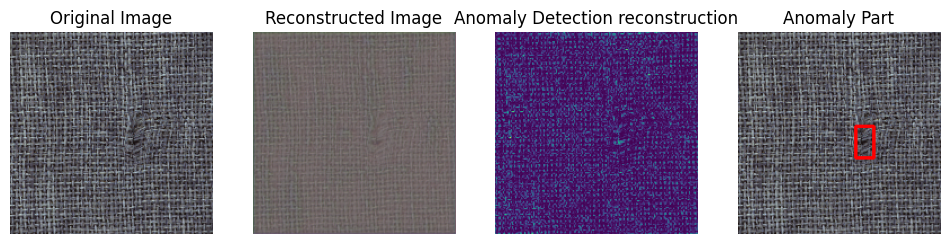

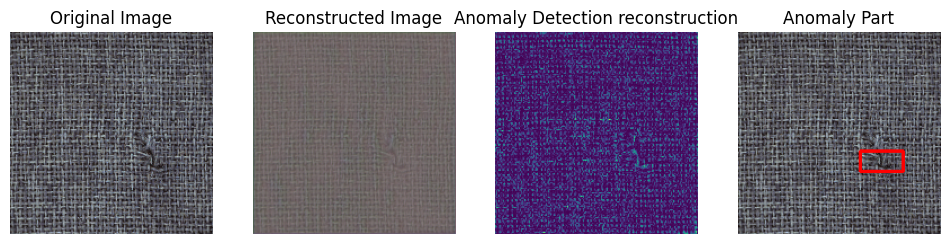

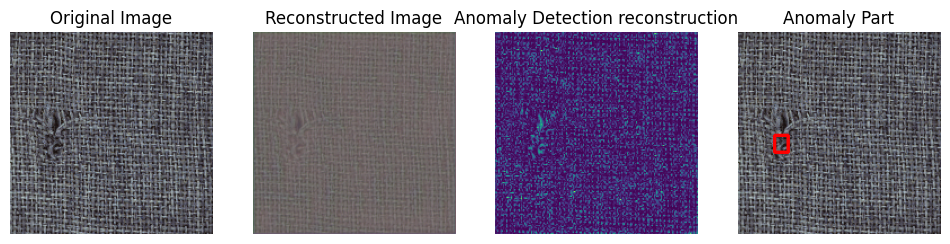

...

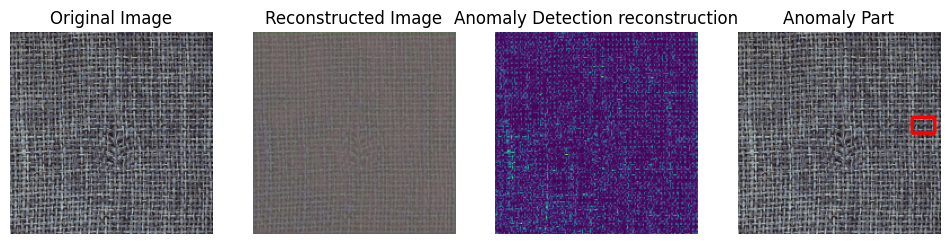

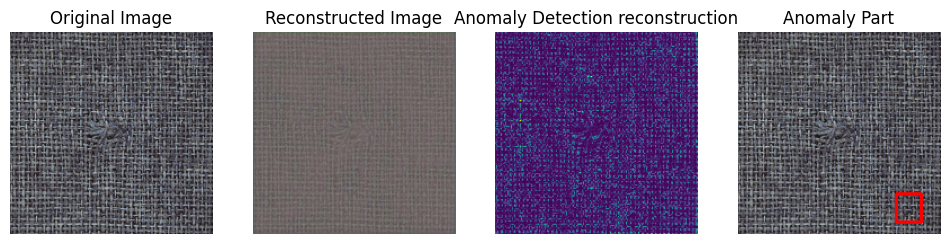

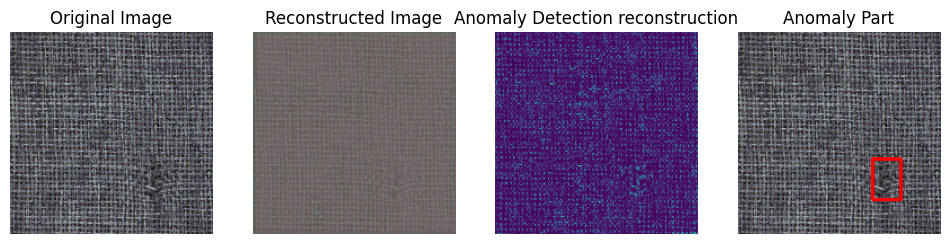

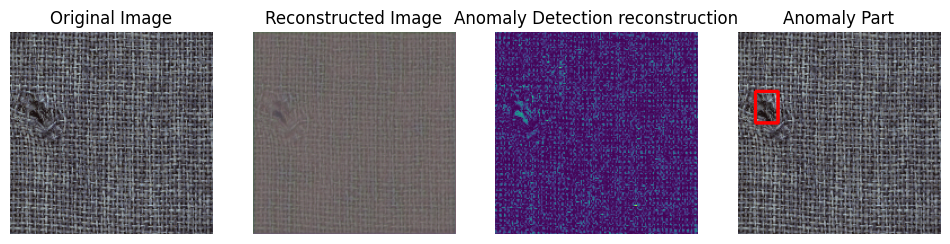

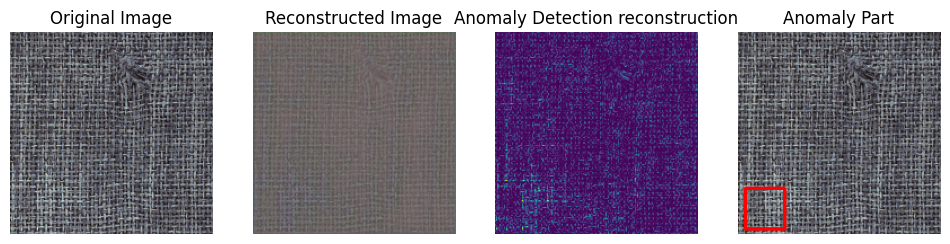

In [ ]:
test_reconstructed_images = autoencoder.predict(norm_anomaly)

# Calculate the reconstruction error (mean squared error)
reconstruction_error_images = tf.keras.losses.mean_squared_error(norm_anomaly, test_reconstructed_images)

# Iterate over each image
for idx in range(len(norm_anomaly)):
    reconstruction_error_image = reconstruction_error_images[idx]

    # Apply threshold to identify pixels with high reconstruction error
    high_error_pixels = (reconstruction_error_image > threshold).numpy().astype(np.uint8)

    # Find contours of high error areas
    contours, _ = cv2.findContours(high_error_pixels, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Check if there are contours before proceeding
    if contours:
        # Select the largest bounding box
        largest_bounding_box = max(contours, key=cv2.contourArea)

        # Reduce the size of the bounding box for each anomaly area (e.g., by a factor of 0.8)
        x, y, w, h = cv2.boundingRect(largest_bounding_box)
        reduced_bounding_box = (int(x + 0.1 * w), int(y + 0.1 * h), int(0.8 * w), int(0.8 * h))

        # Draw rectangle on the original image
        result_image = np.copy(norm_anomaly[idx])
        x, y, w, h = reduced_bounding_box
        cv2.rectangle(result_image, (x, y), (x + w, y + h), (255, 0, 0), 2)  # Draw a red rectangle

        # Display the images with the rectangle
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 4, 1)
        plt.imshow(norm_anomaly[idx])
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 4, 2)
        plt.imshow(test_reconstructed_images[idx])
        plt.title('Reconstructed Image')
        plt.axis('off')

        plt.subplot(1, 4, 3)
        plt.title("Anomaly Detection reconstruction")
        plt.imshow(reconstruction_error_numpy[idx])
        plt.axis('off')

        plt.subplot(1, 4, 4)
        plt.imshow(result_image)
        plt.title('Anomaly Part')
        plt.axis('off')

    else:
        print(f"No contours found for image {idx + 1}")

plt.show()


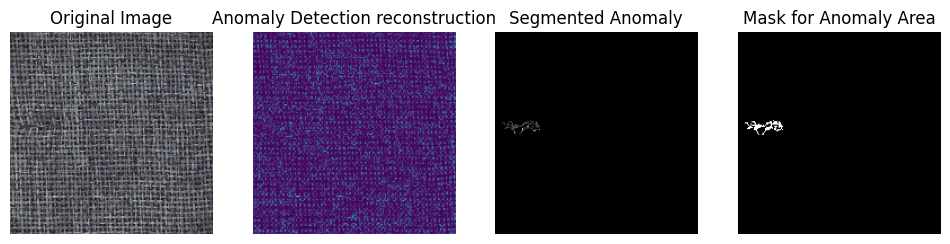

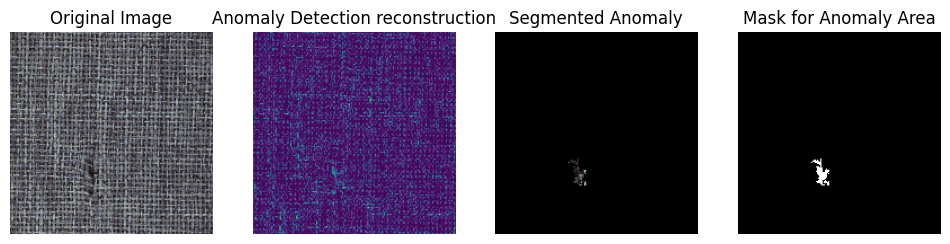

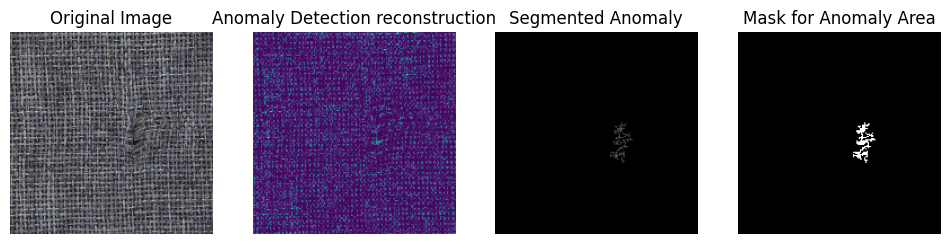

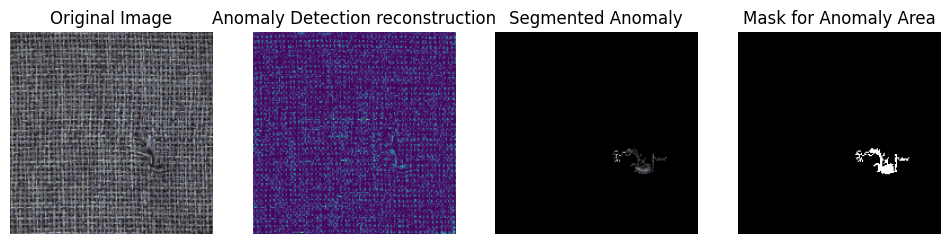

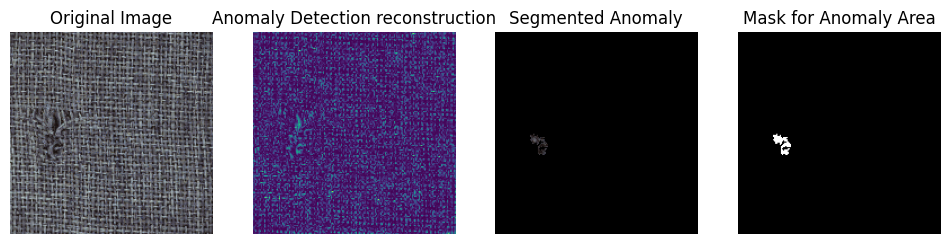

...

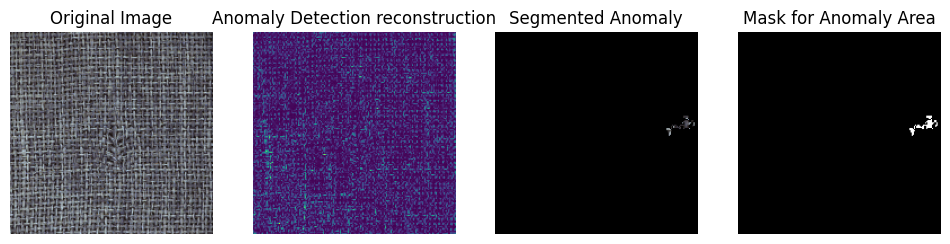

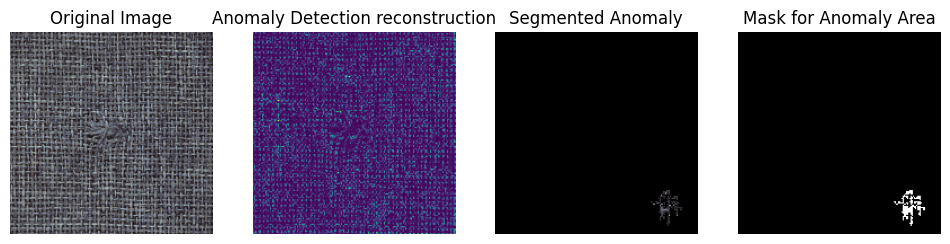

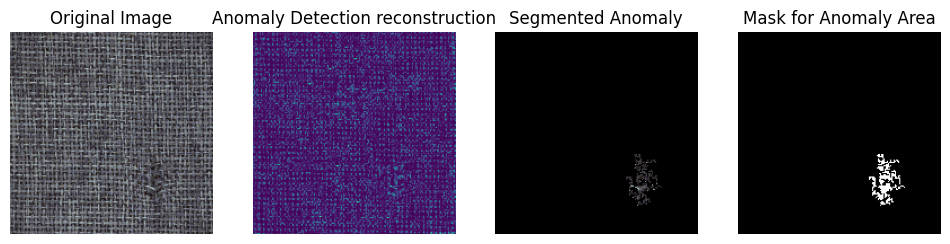

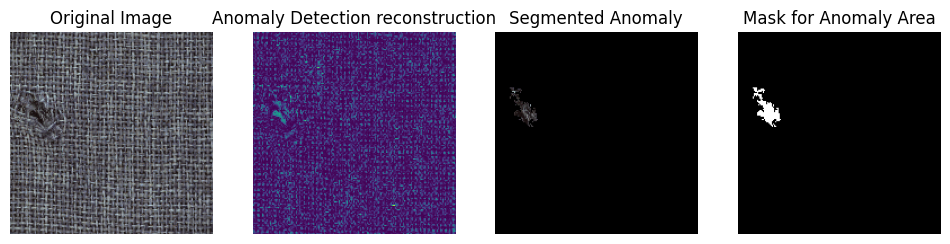

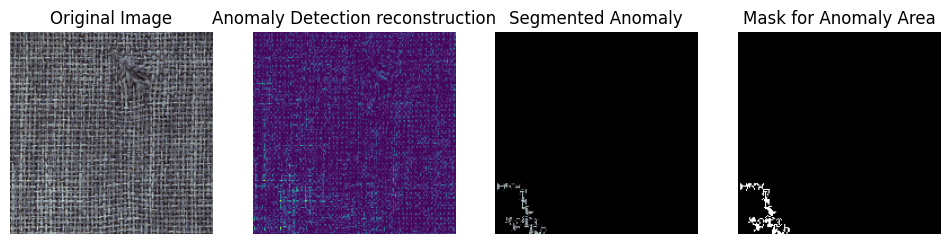

In [ ]:
# Assuming you've obtained the mask and contours as before

# Iterate over each image
for idx in range(len(norm_anomaly)):
    reconstruction_error_image = reconstruction_error_images[idx]

    # Apply threshold to identify pixels with high reconstruction error
    high_error_pixels = (reconstruction_error_image > threshold).numpy().astype(np.uint8)

    # Find contours of high error areas
    contours, _ = cv2.findContours(high_error_pixels, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Check if there are contours before proceeding
    if contours:
        # Select the largest bounding box
        largest_contour = max(contours, key=cv2.contourArea)

        # Create a mask for the anomaly area based on the largest contour
        mask = np.zeros(norm_anomaly[idx].shape[:2], dtype=np.uint8)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

        # Apply the mask to the original image for segmentation
        segmented_image = cv2.bitwise_and(norm_anomaly[idx], norm_anomaly[idx], mask=mask)

        # Display the images with segmentation
        plt.figure(figsize=(12, 8))
        plt.subplot(1, 4, 1)
        plt.imshow(norm_anomaly[idx])
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 4, 2)
        plt.title("Anomaly Detection reconstruction")
        plt.imshow(reconstruction_error_numpy[idx])
        plt.axis('off')

        plt.subplot(1, 4, 3)
        plt.imshow(segmented_image)
        plt.title('Segmented Anomaly')
        plt.axis('off')

        plt.subplot(1, 4, 4)
        plt.imshow(mask, cmap='gray')
        plt.title('Mask for Anomaly Area')
        plt.axis('off')

    else:
        print(f"No contours found for image {idx + 1}")

plt.show()
